# Overfitting on all grasps of one object

In this notebook, we provide code to train and overfit a model on all the grasps of one object

This training works for all unconstrained or constrained grasps. 

The difference here is that since the object is fixed, we don't provide the object (or its corresponding voxel grid) to the model as an input

In [303]:
import os
import json
import h5py
import trimesh
import trimesh.path
import trimesh.transformations as tra
import numpy as np
from acronym_tools import load_mesh, load_grasps, create_gripper_marker
import torch
from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader
import numpy as np
import torch
from torch.utils.data import TensorDataset
import numpy as np
from scipy.spatial.transform import Rotation as R

def decompose_matrix(matrix):
    # Extract translation vector
    translation = matrix[:3, 3]

    # Extract the 3x3 rotation matrix
    rotation_matrix = matrix[:3, :3]

    # Convert rotation matrix to quaternion
    quaternion = R.from_matrix(rotation_matrix).as_quat()

    return translation, quaternion

def compose_matrix(position, quaternion):
    # Create a 3x3 rotation matrix from the quaternion
    rotation_matrix = R.from_quat(quaternion).as_matrix()

    # Create a 4x4 transformation matrix
    transformation_matrix = np.eye(4)
    
    # Set the rotation part of the matrix
    transformation_matrix[:3, :3] = rotation_matrix
    
    # Set the translation part of the matrix
    transformation_matrix[:3, 3] = position

    return transformation_matrix

class NoiseScheduler():
    def __init__(self,
                 num_timesteps=1000,
                 beta_start=0.0001,
                 beta_end=0.02,
                 beta_schedule="linear"):

        self.num_timesteps = num_timesteps
        if beta_schedule == "linear":
            self.betas = torch.linspace(
                beta_start, beta_end, num_timesteps, dtype=torch.float32)
        elif beta_schedule == "quadratic":
            self.betas = torch.linspace(
                beta_start ** 0.5, beta_end ** 0.5, num_timesteps, dtype=torch.float32) ** 2

        self.alphas = 1.0 - self.betas
        self.alphas_cumprod = torch.cumprod(self.alphas, axis=0)
        self.alphas_cumprod_prev = F.pad(
            self.alphas_cumprod[:-1], (1, 0), value=1.)

        # required for self.add_noise
        self.sqrt_alphas_cumprod = self.alphas_cumprod ** 0.5
        self.sqrt_one_minus_alphas_cumprod = (1 - self.alphas_cumprod) ** 0.5

        # required for reconstruct_x0
        self.sqrt_inv_alphas_cumprod = torch.sqrt(1 / self.alphas_cumprod)
        self.sqrt_inv_alphas_cumprod_minus_one = torch.sqrt(
            1 / self.alphas_cumprod - 1)

        # required for q_posterior
        self.posterior_mean_coef1 = self.betas * torch.sqrt(self.alphas_cumprod_prev) / (1. - self.alphas_cumprod)
        self.posterior_mean_coef2 = (1. - self.alphas_cumprod_prev) * torch.sqrt(self.alphas) / (1. - self.alphas_cumprod)

    def reconstruct_x0(self, x_t, t, noise):
        s1 = self.sqrt_inv_alphas_cumprod[t]
        s2 = self.sqrt_inv_alphas_cumprod_minus_one[t]
        s1 = s1.reshape(-1, 1)
        s2 = s2.reshape(-1, 1)
        return s1 * x_t - s2 * noise

    def q_posterior(self, x_0, x_t, t):
        s1 = self.posterior_mean_coef1[t]
        s2 = self.posterior_mean_coef2[t]
        s1 = s1.reshape(-1, 1)
        s2 = s2.reshape(-1, 1)
        mu = s1 * x_0 + s2 * x_t
        return mu

    def get_variance(self, t):
        if t[0].sum() == 0:
            return torch.zeros(t.shape)

        variance = self.betas[t] * (1. - self.alphas_cumprod_prev[t]) / (1. - self.alphas_cumprod[t])
        variance = variance.clip(1e-20)
        return variance

    def step(self, model_output, timestep, sample):
        t = timestep
        pred_original_sample = self.reconstruct_x0(sample, t, model_output)
        pred_prev_sample = self.q_posterior(pred_original_sample, sample, t)

        variance = torch.zeros(t.shape)
        if t[0] > 100:
            noise = torch.randn_like(model_output)
            variance = (self.get_variance(t) ** 0.5) * noise

        pred_prev_sample = pred_prev_sample + variance

        return pred_prev_sample

    def add_noise(self, x_start, x_noise, timesteps):
        s1 = self.sqrt_alphas_cumprod[timesteps]
        s2 = self.sqrt_one_minus_alphas_cumprod[timesteps]

        s1 = s1.reshape(-1, 1)
        s2 = s2.reshape(-1, 1)
        # s1 = s1.unsqueeze(0)
        # s2 = s2.unsqueeze(0)

        return s1 * x_start + s2 * x_noise

    def __len__(self):
        return self.num_timesteps

Defining a simple MLP

In [304]:
from positional_embeddings import PositionalEmbedding

class Block(nn.Module):
    def __init__(self, size: int):
        super().__init__()

        self.ff = nn.Linear(size, size)
        # self.bn = nn.BatchNorm1d(size)
        self.act = nn.ReLU()

    def forward(self, x: torch.Tensor):
        return x + self.act(self.ff(x))


class MLP(nn.Module):
    def __init__(self, hidden_size: int = 128, hidden_layers: int = 2, emb_size: int = 128,
                 time_emb: str = "sinusoidal", input_emb: str = "sinusoidal"):
        super().__init__()

        self.time_mlp = PositionalEmbedding(emb_size, time_emb)
        scaler = 25.0
        self.input_mlp = PositionalEmbedding(emb_size, input_emb, scale=scaler)

        concat_size = len(self.time_mlp.layer) + (len(self.input_mlp.layer) * 7)
        layers = [nn.Linear(concat_size, hidden_size), nn.ReLU()]
        for _ in range(hidden_layers):
            layers.append(Block(hidden_size))
        layers.append(nn.Linear(hidden_size, 7))
        self.joint_mlp = nn.Sequential(*layers)

    def forward(self, x, t):
        # print("X Shape: ", x.shape)
        x_emb = self.input_mlp(x)
        x_emb = nn.Flatten(1)(x_emb)
        t_emb = self.time_mlp(t)
        # print(x_emb.shape, t_emb.shape)
        # x = torch.cat((x1_emb, x2_emb, x3_emb, x4_emb, x5_emb, x6_emb, x7_emb, t_emb), dim=-1)
        x = torch.cat((x_emb, t_emb), dim=-1)
        # print("WHATS THE SHAPE: ", x.shape)
        x = self.joint_mlp(x)
        return x

Read and convert any grasp file to a small torch dataset of grasps

In [262]:

grasp_path = "/Users/username/Desktop/TUM/Courses/Sem 3/DL_Robotics/Project/tum-adlr-03/data/grasp/Cup_64ce0c349a57f9ca488887a53f46a53_0_02064541566339134.h5"
# grasp_path = "/Users/username/Desktop/TUM/Courses/Sem 3/DL_Robotics/Project/Grasping_Ours/examples/grasps/Table_99cf659ae2fe4b87b72437fd995483b_0.009700376721042367.h5"

with h5py.File(grasp_path, 'r') as data:
    mesh_fname = data["object/file"][()].decode('utf-8')
    # mesh_type = mesh_fname.split('/')[1]
    # mesh_id = mesh_fname.split('/')[-1].split('.')[0]
    mesh_scale = data["object/scale"][()]
    mesh_norm_scale = data["object/norm_scale"][()]

    grasps = data['grasps/transforms'][()]
    qp_unscaled = data["object/query_points"][()]
    cam_pose_inv = data["camera_pose_inv"][()]

arr = []

for grasp in grasps:
    position, quaternion = decompose_matrix(grasp)
    f1 = np.array(position.tolist() + quaternion.tolist())
    arr.append(f1)
    # break;
arr = np.array(arr)
print(arr.shape)
# arr[3:5]

final_grasp_arr = torch.from_numpy(arr.astype(np.float32))

(137, 7)


In [265]:
train_dataset = TensorDataset(final_grasp_arr)

In [266]:
noise_scheduler = NoiseScheduler(num_timesteps=100)

In [284]:
model = MLP(hidden_size=1024, hidden_layers=2, emb_size=64, input_emb="sinusoidal", time_emb="sinusoidal")

optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

from torchsummary import summary

print(summary(model))

Layer (type:depth-idx)                   Param #
├─PositionalEmbedding: 1-1               --
|    └─SinusoidalEmbedding: 2-1          --
├─PositionalEmbedding: 1-2               --
|    └─SinusoidalEmbedding: 2-2          --
├─Sequential: 1-3                        --
|    └─Linear: 2-3                       525,312
|    └─ReLU: 2-4                         --
|    └─Block: 2-5                        --
|    |    └─Linear: 3-1                  1,049,600
|    |    └─ReLU: 3-2                    --
|    └─Block: 2-6                        --
|    |    └─Linear: 3-3                  1,049,600
|    |    └─ReLU: 3-4                    --
|    └─Linear: 2-7                       7,175
Total params: 2,631,687
Trainable params: 2,631,687
Non-trainable params: 0
Layer (type:depth-idx)                   Param #
├─PositionalEmbedding: 1-1               --
|    └─SinusoidalEmbedding: 2-1          --
├─PositionalEmbedding: 1-2               --
|    └─SinusoidalEmbedding: 2-2          --
├─Sequential

In [285]:
dataloader = DataLoader(
        train_dataset, batch_size=16, shuffle=False, drop_last=False)

In [286]:
# for step, batch in enumerate(dataloader):
#         batch = batch[0]

#         timesteps = torch.randint(
#         0, noise_scheduler.num_timesteps, (batch.shape[0],)
#         ).long()

#         noise_pred = model(batch, timesteps)
#         break;

In [287]:
def weight_reset(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
        m.reset_parameters()

model.apply(weight_reset)

MLP(
  (time_mlp): PositionalEmbedding(
    (layer): SinusoidalEmbedding()
  )
  (input_mlp): PositionalEmbedding(
    (layer): SinusoidalEmbedding()
  )
  (joint_mlp): Sequential(
    (0): Linear(in_features=512, out_features=1024, bias=True)
    (1): ReLU()
    (2): Block(
      (ff): Linear(in_features=1024, out_features=1024, bias=True)
      (act): ReLU()
    )
    (3): Block(
      (ff): Linear(in_features=1024, out_features=1024, bias=True)
      (act): ReLU()
    )
    (4): Linear(in_features=1024, out_features=7, bias=True)
  )
)

In [288]:
from tqdm import tqdm
from tqdm import tqdm
from torch.optim.lr_scheduler import ExponentialLR, ReduceLROnPlateau, StepLR

# scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, step_size=100, gamma=0.5)
# gamma = 0.95  # Multiplicative factor by which to adjust the learning rate
# scheduler = ExponentialLR(optimizer, gamma=gamma)
scheduler = ReduceLROnPlateau(optimizer, 'min', patience=250, verbose=True)

global_step = 0
frames = []
losses = []
avg_epoch_loss = []
print("Training model...")
model.train()
for epoch in tqdm(range(5000)):
    temp_losses = []
    for step, batch in enumerate(dataloader):
        optimizer.zero_grad()
        batch = batch[0]
        noise = torch.randn(batch.shape)
    
        # timesteps = torch.randint(0, noise_scheduler.num_timesteps, (1,)).long()
        # timesteps = timesteps * torch.ones(batch.shape[0])
        timesteps = torch.randint(0, noise_scheduler.num_timesteps, (batch.shape[0],)).long()
        
        # num = epoch + 1
        # print(num % 1000)
        # timesteps = torch.Tensor(np.repeat(num % 1000, 1)).long()
        # timesteps = (timesteps * torch.ones(batch.shape[0],)).long()
        # print(timesteps)
        # print(batch.shape, noise.shape, timesteps.shape)

        noisy = noise_scheduler.add_noise(batch, noise, timesteps.long())

        # noisy.shape, noise.shape, timesteps.shape

        noise_pred = model(noisy, timesteps)

        loss = F.mse_loss(noise_pred, noise)
        loss.backward(loss)

        # nn.utils.clip_grad_norm_(model.parameters(), 1.0)
        optimizer.step()

        losses.append(loss.detach().item())
        temp_losses.append(loss.detach().item())

        # model.eval()
        # with torch.no_grad():
        #     for step, batch in enumerate(val_dataloader):

        #         batch = batch[0]
        #         noise = torch.randn(batch.shape)
        #         t1 = torch.from_numpy(np.repeat(t, batch.shape[0])).long()

        #         noisy = noise_scheduler.add_noise(batch, noise, t1)

        #         noise_pred = model(noisy, t1)

        #         loss = F.mse_loss(noise_pred, noise)
        #         frames.append(loss.detach().item())
    scheduler.step(np.mean(np.array(temp_losses)))
    avg_epoch_loss.append(np.mean(np.array(temp_losses)))
    # break;

Training model...


 25%|██▍       | 1248/5000 [01:12<04:18, 14.51it/s]

Epoch 01247: reducing learning rate of group 0 to 1.0000e-05.


 34%|███▍      | 1716/5000 [01:40<03:12, 17.05it/s]

Epoch 01713: reducing learning rate of group 0 to 1.0000e-06.


 39%|███▉      | 1966/5000 [01:55<02:58, 16.96it/s]

Epoch 01964: reducing learning rate of group 0 to 1.0000e-07.


 44%|████▍     | 2218/5000 [02:10<02:44, 16.92it/s]

Epoch 02215: reducing learning rate of group 0 to 1.0000e-08.


100%|██████████| 5000/5000 [04:53<00:00, 17.04it/s]


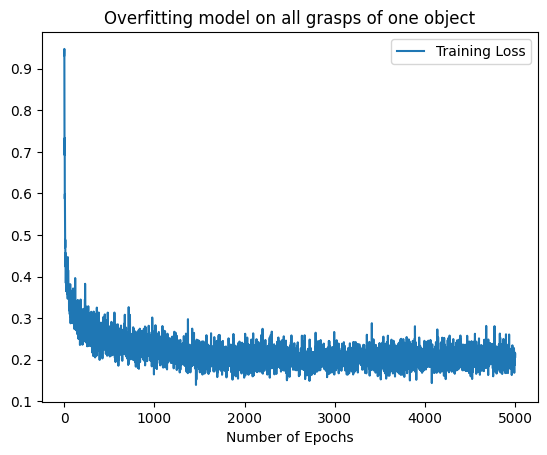

In [289]:
import matplotlib.pyplot as plt

# plt.plot(losses)
x = [i for i in range(1, len(avg_epoch_loss))]
plt.plot(x, avg_epoch_loss[1:], label = "Training Loss")
plt.legend(loc="upper right")
plt.xlabel("Number of Epochs")
plt.title("Overfitting model on all grasps of one object")
# plt.savefig("training_loss.png", dpi=500)
plt.show()

## Evaluating and visualizing the grasps generated

In [ ]:
import os
import json
import h5py
import trimesh
import trimesh.path
import trimesh.transformations as tra
import numpy as np
# from acronym_tools import load_mesh, load_grasps, create_gripper_marker

import os, json
import trimesh
import mesh2sdf
import numpy as np
from scipy.spatial.transform import Rotation as R
from tqdm import tqdm
import pickle

def makedirs(dirname):
    if not os.path.exists(dirname):
        os.makedirs(dirname)

def create_voxel_grid(mesh, n=32):
    """
    Uses the the mesh2sdf library to convert the mesh into a (n x n x n) voxel grid
    The values within the grid are sdf (signed distance function) values
    Input - 
        1. mesh_path --> Path to mesh file (.obj file)
        2. n --> size of voxel grid
    Output - 
        1. mesh --> mesh object after loading, normalizing and fixing mesh
        2. sdf --> (n x n x n) numpy array 
    """

    # try:
    mesh_scale = 0.8
    size = n
    level = 2 / size

    # normalize mesh
    vertices = mesh.vertices
    bbmin = vertices.min(0)
    bbmax = vertices.max(0)
    center = (bbmin + bbmax) * 0.5
    scale = 2.0 * mesh_scale / (bbmax - bbmin).max()
    vertices = (vertices - center) * scale
    # mesh.vertices = vertices
    # mesh_scaled = mesh.apply_scale(scale)

    sdf = mesh2sdf.compute(
        vertices, mesh.faces, size, fix=True, level=level, return_mesh=False)

    mesh.vertices = vertices
    return sdf, scale, center, mesh


def create_gripper_marker(color=[0, 0, 255], tube_radius=0.001, sections=6):
    """Create a 3D mesh visualizing a parallel yaw gripper. It consists of four cylinders.

    Args:
        color (list, optional): RGB values of marker. Defaults to [0, 0, 255].
        tube_radius (float, optional): Radius of cylinders. Defaults to 0.001.
        sections (int, optional): Number of sections of each cylinder. Defaults to 6.

    Returns:
        trimesh.Trimesh: A mesh that represents a simple parallel yaw gripper.
    """
    cfl = trimesh.creation.cylinder(
        radius=0.002,
        sections=sections,
        segment=[
            [4.10000000e-02, -7.27595772e-12, 6.59999996e-02],
            [4.10000000e-02, -7.27595772e-12, 1.12169998e-01],
        ],
    )
    cfr = trimesh.creation.cylinder(
        radius=0.002,
        sections=sections,
        segment=[
            [-4.100000e-02, -7.27595772e-12, 6.59999996e-02],
            [-4.100000e-02, -7.27595772e-12, 1.12169998e-01],
        ],
    )
    cb1 = trimesh.creation.cylinder(
        radius=0.002, sections=sections, segment=[[0, 0, 0], [0, 0, 6.59999996e-02]]
    )
    cb2 = trimesh.creation.cylinder(
        radius=0.002,
        sections=sections,
        segment=[[-4.100000e-02, 0, 6.59999996e-02], [4.100000e-02, 0, 6.59999996e-02]],
    )

    tmp = trimesh.util.concatenate([cb1, cb2, cfr, cfl])
    tmp.visual.face_colors = color

    return tmp

def compose_matrix(position, quaternion):
    # Create a 3x3 rotation matrix from the quaternion
    rotation_matrix = R.from_quat(quaternion).as_matrix()

    # Create a 4x4 transformation matrix
    transformation_matrix = np.eye(4)
    
    # Set the rotation part of the matrix
    transformation_matrix[:3, :3] = rotation_matrix
    
    # Set the translation part of the matrix
    transformation_matrix[:3, 3] = position

    return transformation_matrix

In [291]:
model.eval()

gen_grasps = []
for k in tqdm(range(20)):

    sample = torch.randn(1, 7)
    timesteps = list(range(len(noise_scheduler)))[::-1]

    for i, t in enumerate(timesteps):
        # print(t)
        t = torch.from_numpy(np.repeat(t, 1)).long()
        # t = (t * torch.ones(7)).unsqueeze(0).long()
        # print(t.shape)
        with torch.no_grad():
            residual = model(sample, t)
        residual
        sample = noise_scheduler.step(residual, t, sample)

    gen_grasps.append(sample)

100%|██████████| 20/20 [00:00<00:00, 49.59it/s]


In [292]:
g = []
for i in gen_grasps:
    # print(i)
    viz = compose_matrix(i[0][:3], i[0][3:])
    g.append(create_gripper_marker(color=[0, 255, 0]).apply_transform(viz))
g

[<trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertices.shape=(56, 3), faces.shape=(96, 3))>,
 <trimesh.Trimesh(vertice

In [294]:
with h5py.File(grasp_path, 'r') as data:
    mesh_fname = data["object/file"][()].decode('utf-8')
    # mesh_type = mesh_fname.split('/')[1]
    # mesh_id = mesh_fname.split('/')[-1].split('.')[0]
    mesh_scale = data["object/scale"][()]
    mesh_norm_scale = data["object/norm_scale"][()]

    grasps = data['grasps/transforms'][()]
    qp_unscaled = data["object/query_points"][()]
    cam_pose_inv = data["camera_pose_inv"][()]

print(f"Number of Query Points: {qp_unscaled.shape[0]}")
print(f"Number of Grasps: {grasps.shape[0]}")

Number of Query Points: 687
Number of Grasps: 137


In [295]:
"""File path to object for visualization"""

mesh_fname = "/Users/username/Desktop/TUM/Courses/Sem 3/DL_Robotics/Project/tum-adlr-03/data/meshes/Cup/64ce0c349a57f9ca488887a53f46a53.obj"

mesh = trimesh.load(mesh_fname, force='mesh')
mesh = mesh.apply_scale(mesh_scale)
mesh.bounds

array([[-0.03737312, -0.03743077, -0.00814631],
       [ 0.03732484,  0.0373573 ,  0.07720089]])

In [296]:
sdf, norm_scale, center_scale, mesh = create_voxel_grid(mesh, n=32)

print(mesh_norm_scale, norm_scale)

# output_fname = os.path.join(voxels_dirname, os.path.splitext(os.path.basename(grasp_fname))[0] + ".npz")
# sdf = torch.from_numpy(np.load(output_fname)['arr_0']).float()


18.746951952974147 18.746951952974147


In [297]:
qp_scaled = (qp_unscaled - center_scale) * norm_scale

In [298]:
generated_grasps = [i.apply_scale(norm_scale) for i in g]

In [299]:
# trimesh.Scene([mesh]+generated_grasps[:5]).show()

In [300]:
points = qp_scaled

sphere_color = [150, 0, 0, 255]
mesh.visual.face_colors = sphere_color

# Create a small sphere for each point with the specified color
spheres = [trimesh.primitives.Sphere(radius=0.05, center=point) for point in points]

# Assign the color to each sphere
# for sphere in spheres:
#     sphere.visual.face_colors = sphere_color

# Combine the original mesh with the colored spheres
combined_mesh = trimesh.util.concatenate([mesh] + spheres)

trimesh.Scene([combined_mesh] + generated_grasps[:5]).show()